# Fourier beam propagation

Fourier beam propagation works by decomposing a beam into plane waves, advancing the phase of each plane wave to propagate a set distance in $z$, and then transforming back again.  This is a relatively simple procedure that allows us to see how a beam evolves in space.
The next cell sets up some imports etc. and doesn't do any interesting simulation.

In [1]:
%matplotlib inline

import numpy as np
import matplotlib.pyplot as plt
import scipy

The first thing to do is to define an input beam.  We'll use complex numbers to represent amplitude and phase.  We think about one plane at a time, so the first one we'll define is $E_{\mathrm{in}}$ at $z=0$.

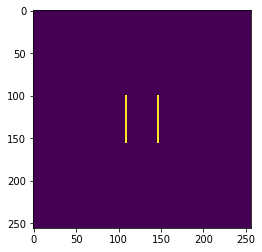

In [2]:
Ein = np.zeros((256, 256), dtype=complex)
N = Ein.shape[0]

# This will make a double slit
Ein[100:156, 108:110] = 1
Ein[100:156, 146:148] = 1

plt.imshow(np.abs(Ein)**2)

## Doing the Fourier transform
Fourier transforms are separable, which is to say you can apply them along the dimensions separately.  We can start with a function `fft` that works in 1D, then apply it along X and Y in turn:

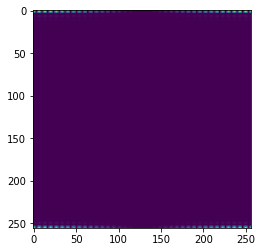

In [3]:
from scipy.fft import fft, fftshift

FT = np.zeros_like(Ein)
for i in range(FT.shape[0]):
    FT[i, :] = fft(fftshift(Ein[i,:]))
for i in range(FT.shape[1]):
    FT[:,i] = fft(fftshift(FT[:,i]))
plt.imshow(np.abs(FT)**2)

The first thing to notice here is that the top and bottom rows are bright - this should seem odd: we'd expect most of the power to be at $k_y=0$.  This is actually normal for discrete Fourier transforms - usually, zero frequency is at the start of the array, followed by positive frequencies, then negative ones.  We can shift the zero position into the middle:

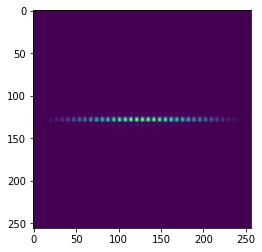

In [4]:
from scipy.fft import fftshift

FT = fftshift(FT)

plt.imshow(np.abs(FT)**2)

It turns out that there's already a (faster, but basically identical) routine for a 2D Fourier transform, and we'll use that from now on:

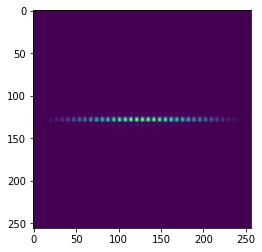

In [5]:
from scipy.fft import fft2

FT = fftshift(fft2(fftshift(Ein)))
plt.imshow(np.abs(FT)**2)

## Scaling factors
One of the first things to establish is sensible scaling factors.  In the interests of not getting bogged down in too many variables, I'll use pixels as our unit of distance.  We then need to pick the wavevector $k$ in units of radians per pixel.  If we had 633nm light and a 1cm wide input aperture, then each pixel is about $40\,\mu$m so $k\approx 400\,\mathrm{rad}\mathrm{px}^{-1}$.

We'll do a discrete Fourier transform on this, and the pixel pitch is dictated by the size of the input array.  The highest frequencies will correspond to adjacent pixels in the real-space image being out of phase by $\pi$ (i.e. $k_{\mathrm{max}}=\pi$) and the step in spatial frequency will be set by the width of the array $N=256$ so $\Delta k={2\pi\over N}$.  Note that this means we're very far from having any evanescent components!  That's not possible with pixels this big.

The next cell attempts to scale the X and Y axes to be in sensible units.

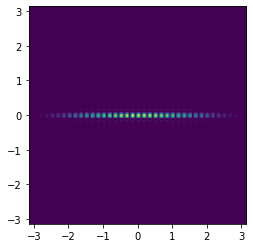

In [6]:
from scipy.fft import fftfreq

k_extent = (-np.pi, np.pi, -np.pi, np.pi)

plt.imshow(np.abs(FT)**2, extent=k_extent)

# Propagating the beam
Now that we can competently take the Fourier transform, and we can calculate $k_\perp$ for each pixel, it's possible to calculate $k_z$ for each pixel in the Fourier transform.  This then allows us to shift each plane wave component by the correct amount.  Remember:
$$k_z = \sqrt{k^2 - k_y^2 - k_x^2}$$

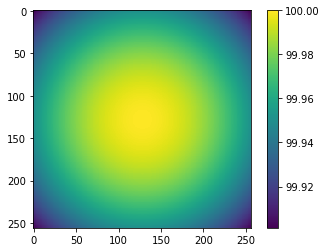

In [7]:
k = 100  # This is the total wavevector

# First, construct 1D arrays with kx and ky values
ii = np.arange(N) - N//2
kx = ii / N * 2 * np.pi
ky = kx
# Next calculate k_z:
kz = np.sqrt(k**2 - kx[:, np.newaxis]**2 - ky[np.newaxis, :]**2)

plt.imshow(kz)
plt.colorbar()

Now that we know $k_z$, we can advance the phases of the plane waves and transform back, to propagate the wave:

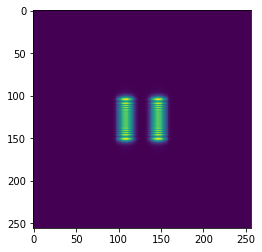

In [8]:
from scipy.fft import ifft2

z = 500 # i.e. we're propagating about 8 simulation-widths in Z

FT = fftshift(fft2(Ein))
FT *= np.exp(1j*kz*z)
Eout = ifft2(fftshift(FT))

plt.imshow(np.abs(Eout)**2)

We can visualise this more nicely with a little animation.  The next cell just borrows some code from the wavetank notebook to make nice little animations.

In [9]:
# This next bit sets things up for animation.
import matplotlib
import matplotlib.animation
from contextlib import contextmanager
# Set the default animation method to be JavaScript + HTML, which we can easily 
# embed in a notebook.
plt.rcParams["animation.html"] = "jshtml"
# Set the default plot backend to be "inline", i.e. plot to a PNG and display
# it below the cell.
%matplotlib inline
%matplotlib inline

# If we're using the "inline" backend, then when we make animations, we will
# render two graphs, one animated and one static.  This context manager allows
# us to suppress the static one.
@contextmanager
def hide_matplotlib_figures():
    """Temporarily stop graphs being displayed.
    
    If we animate graphs using matplotlib.animate, it
    is desirable to not show the graph directly.  If 
    we are using "inline" graphs, this happens automatically.
    This block of code temporarily disables inline graphs, so
    we can set up an animation, and then display it later.
    
    Example:
    ```
    with hide_matplotlib_figures():
      fig, ax = plt.subplots(1,1)

    # Insert animation code here (it doesn't need to be indented)
    matplotlib.animation.FuncAnimation(...)
    ```
    """
    backend_ =  matplotlib.get_backend() 
    matplotlib.use("Agg", warn=False)  # Prevent showing stuff
    matplotlib.use("Agg", warn=False)  # (sometimes needed twice!)
    try:
        yield
    finally:
        matplotlib.use(backend_, warn=False)  # Restore original setting
        
def animate_stack(stack, vmin=0, vmax=None, renorm=False):
    """Display a stack of frames as an animation
    
    vmin and vmax set the min and max pixel values in the 
    colourmap.
    
    renorm, if set to True, will set the max colour to the
    highest pixel in the current stack each frame.
    """
    if vmax is None:
      vmax = np.max(stack)
    n_frames = stack.shape[0]
    with hide_matplotlib_figures():
      fig, ax = plt.subplots(1, 1, figsize=(8,6))
    image = ax.imshow(stack[0, ...], vmin=vmin, vmax=vmax)

    def animate(i):
      """Display the ith frame"""
      image.set_data(stack[i, ...])
      if renorm:
        image.norm.vmax = np.max(stack[i, ...])
      return (image, )

    return matplotlib.animation.FuncAnimation(fig, animate, n_frames, blit=True)

In [12]:
zs = np.linspace(0,10000,80)

intensities = np.zeros((len(zs),) + Ein.shape, dtype=float)
FT = fftshift(fft2(fftshift(Ein)))
for i, z in enumerate(zs):
    Eout = fftshift(ifft2(fftshift(FT * np.exp(1j*kz*z))))
    intensities[i, ...] = np.abs(Eout)**2
    
animate_stack(intensities, renorm=True)

Text(0, 0.5, 'Z')

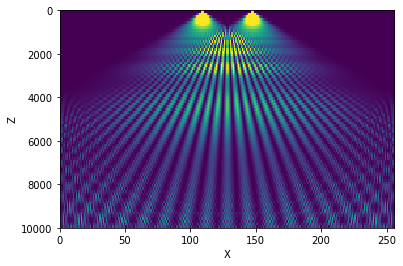

In [13]:
# Plot an x-z slice:

plt.imshow(intensities[:, N//2, :], 
           aspect="auto", vmax=0.1, extent=(0, N, zs.max(), zs.min()))
plt.xlabel("X")
plt.ylabel("Z")

Above, you see the output plane scanned through $z$.  Note the gradual transition from two slits to an interference pattern.  Note also that the pattern seems to zoom in towards the end.  This is because the pixel scaling of the grid doesn't change - so as the diffraction pattern spreads out (it's constant in angle, after all), it appears to get bigger.  If we want to avoid running out of space, we can "zero-pad" the array, so there's more room to grow.  We might want to have fewer frames at that point, though!

Now, playtime! Let's simulate a bunch of different beams and see how they evolve.  We'll start with a square aperture:

In [14]:
Ein = np.zeros_like(Ein)
Ein[118:138, 118:138] = 1

intensities = np.zeros((len(zs),) + Ein.shape, dtype=float)
FT = fftshift(fft2(Ein))
for i, z in enumerate(zs):
    Eout = ifft2(fftshift(FT * np.exp(1j*kz*z)))
    intensities[i, ...] = np.abs(Eout)**2
    
animate_stack(intensities, renorm=True)

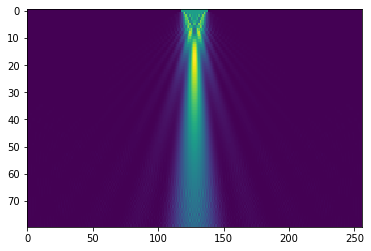

In [15]:
plt.imshow(np.sum(intensities, axis=1), aspect="auto")

This is quite a fun one - as you can see from the animation and the XZ slice, it first appears to focus (mostly the hard edges disappear, and the resulting diffraction gives us a bright central blob).  After that, it spreads out - as is the fate of all propagating beams.

Next, let's try a Gaussian:

In [16]:
Ein = np.zeros_like(Ein)
x = np.arange(N) - N//2
r2 = x[:,np.newaxis]**2 + x[np.newaxis, :]**2
Ein = np.exp(-2*r2/10**2)

intensities = np.zeros((len(zs),) + Ein.shape, dtype=float)
FT = fftshift(fft2(Ein))
for i, z in enumerate(zs):
    Eout = ifft2(fftshift(FT * np.exp(1j*kz*z)))
    intensities[i, ...] = np.abs(Eout)**2

animate_stack(intensities, renorm=True)

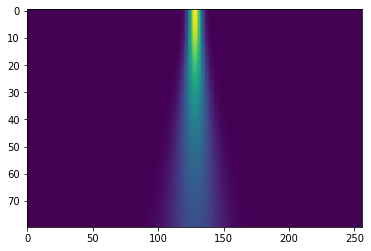

In [17]:
plt.imshow(np.sum(intensities, axis=1), aspect="auto")

The Gaussian doesn't have sharp edges, so it just spreads out, as we expect for a beam of that type.  If we make it smaller, it should spread out more rapidly:

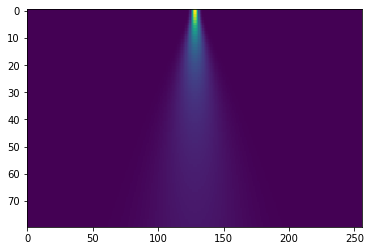

In [18]:
Ein = np.zeros_like(Ein)
x = np.arange(N) - N//2
r2 = x[:,np.newaxis]**2 + x[np.newaxis, :]**2
Ein = np.exp(-2*r2/5**2)

intensities = np.zeros((len(zs),) + Ein.shape, dtype=float)
FT = fftshift(fft2(Ein))
for i, z in enumerate(zs):
    Eout = ifft2(fftshift(FT * np.exp(1j*kz*z)))
    intensities[i, ...] = np.abs(Eout)**2

plt.imshow(np.sum(intensities, axis=1), aspect="auto")

If we're really feeling inventive, what about a bit of phase curvature?  If we make the wave spherical, it should focus before diverging again:

In [19]:
Ein = np.zeros_like(Ein)
x = np.arange(N) - N//2
r2 = x[:,np.newaxis]**2 + x[np.newaxis, :]**2
Ein = np.exp(-2*r2/40**2) * np.exp(-1j * k * r2 / (2*1000))

intensities = np.zeros((len(zs),) + Ein.shape, dtype=float)
FT = fftshift(fft2(Ein))
for i, z in enumerate(zs):
    Eout = ifft2(fftshift(FT * np.exp(1j*kz*z)))
    intensities[i, ...] = np.abs(Eout)**2

animate_stack(intensities, renorm=True)

Note that this descends into noise after it's focused, and also note that it doesn't diverge in a nice Gaussian.  These are all numerical artefacts (mostly surmountable, but I am aiming for simplicity over performance here!

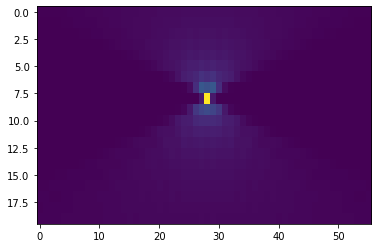

In [24]:
plt.imshow(np.sum(intensities[:20, :, 100:156], axis=1), aspect="auto")